## Using pre-trained NN

In [1]:
!conda install -y nomkl > tmp.log

In [1]:
import numpy as np
import theano
import theano.tensor as T
import lasagne
import _pickle as pickle
import os
import matplotlib.pyplot as plt
%matplotlib inline
import scipy
from scipy.misc import imread, imsave, imresize
from lasagne.utils import floatX
import h5py
from tqdm import tqdm
import PIL
from PIL import Image

# Model Zoo
* https://github.com/Lasagne/Recipes/tree/master/modelzoo
* More models within the community
* Pick model, copy init, download weights
* Here we proceed with vgg16

In [17]:
!wget https://s3.amazonaws.com/lasagne/recipes/pretrained/imagenet/vgg16.pkl

--2017-05-18 01:15:07--  https://s3.amazonaws.com/lasagne/recipes/pretrained/imagenet/vgg16.pkl
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.65.179
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.65.179|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553459517 (528M) [binary/octet-stream]
Saving to: ‘vgg16.pkl’

vgg16.pkl           100%[===================>] 527.82M   110KB/s    in 48m 11s 

2017-05-18 02:03:19 (187 KB/s) - ‘vgg16.pkl’ saved [553459517/553459517]



In [2]:
# copyright: see http://www.robots.ox.ac.uk/~vgg/research/very_deep/


from lasagne.layers import InputLayer
from lasagne.layers import DenseLayer
from lasagne.layers import NonlinearityLayer
from lasagne.layers import DropoutLayer
from lasagne.layers import Pool2DLayer as PoolLayer
from lasagne.layers import Conv2DLayer as ConvLayer
from lasagne.nonlinearities import softmax


def build_model():
    net = {}
    net['input'] = InputLayer((None, 3, 224, 224))
    net['conv1_1'] = ConvLayer(
        net['input'], 64, 3, pad=1, flip_filters=False)
    net['conv1_2'] = ConvLayer(
        net['conv1_1'], 64, 3, pad=1, flip_filters=False)
    net['pool1'] = PoolLayer(net['conv1_2'], 2)
    net['conv2_1'] = ConvLayer(
        net['pool1'], 128, 3, pad=1, flip_filters=False)
    net['conv2_2'] = ConvLayer(
        net['conv2_1'], 128, 3, pad=1, flip_filters=False)
    net['pool2'] = PoolLayer(net['conv2_2'], 2)
    net['conv3_1'] = ConvLayer(
        net['pool2'], 256, 3, pad=1, flip_filters=False)
    net['conv3_2'] = ConvLayer(
        net['conv3_1'], 256, 3, pad=1, flip_filters=False)
    net['conv3_3'] = ConvLayer(
        net['conv3_2'], 256, 3, pad=1, flip_filters=False)
    net['pool3'] = PoolLayer(net['conv3_3'], 2)
    net['conv4_1'] = ConvLayer(
        net['pool3'], 512, 3, pad=1, flip_filters=False)
    net['conv4_2'] = ConvLayer(
        net['conv4_1'], 512, 3, pad=1, flip_filters=False)
    net['conv4_3'] = ConvLayer(
        net['conv4_2'], 512, 3, pad=1, flip_filters=False)
    net['pool4'] = PoolLayer(net['conv4_3'], 2)
    net['conv5_1'] = ConvLayer(
        net['pool4'], 512, 3, pad=1, flip_filters=False)
    net['conv5_2'] = ConvLayer(
        net['conv5_1'], 512, 3, pad=1, flip_filters=False)
    net['conv5_3'] = ConvLayer(
        net['conv5_2'], 512, 3, pad=1, flip_filters=False)
    net['pool5'] = PoolLayer(net['conv5_3'], 2)
    net['fc6'] = DenseLayer(net['pool5'], num_units=4096)
    net['fc6_dropout'] = DropoutLayer(net['fc6'], p=0.5)
    net['fc7'] = DenseLayer(net['fc6_dropout'], num_units=4096)
    net['fc7_dropout'] = DropoutLayer(net['fc7'], p=0.5)
    net['fc8'] = DenseLayer(
        net['fc7_dropout'], num_units=1000, nonlinearity=None)
    net['prob'] = NonlinearityLayer(net['fc8'], softmax)

    return net

In [3]:
#classes' names are stored here
classes = pickle.load((open('classes.pkl', 'rb')))
#for example, 10th class is ostrich:
print(classes[9])

ostrich, Struthio camelus


You have to implement two functions in the cell below.

Preprocess function should take the image with shape (w, h, 3) and transform it into a tensor with shape (1, 3, 224, 224). Without this transformation, vgg19 won't be able to digest input image. 
Additionally, your preprocessing function have to rearrange channels RGB -> BGR and subtract mean values from every channel.

In [2]:
MEAN_VALUES = np.array([104, 117, 123])
IMAGE_W = 224

def preprocess(img):
    img = img[:, :, ::-1]  # switch to BGR
    img = img - MEAN_VALUES
    #convert from [w,h,3 to 1,3,w,h]
    img = np.transpose(img, (2, 0, 1))[None]
    return img.astype('int16')


def deprocess(img):
    img = img.reshape(img.shape[1:]).transpose((1, 2, 0))
    for i in range(3):
        img[:,:, i] += MEAN_VALUES[i]
    return img[:, :, :: -1].astype('int16')
img = (np.random.rand(IMAGE_W, IMAGE_W, 3) * 256)

print (np.linalg.norm(deprocess(preprocess(img)) - img))

223.887587713


If your implementation is correct, the number above will be small, because deprocess function is the inverse of preprocess function

### Deploy the network

In [5]:
net = build_model()

In [6]:
import pickle

with open('vgg16.pkl', 'rb') as f:
    weights = pickle.load(f, encoding='latin-1')['param values']


In [9]:
input_image = T.tensor4('input')
output = lasagne.layers.get_output(net['prob'], input_image)
prob = theano.function([input_image], output) 

### Sanity check
Давайте проверим, что загруженная сеть работает. Для этого мы скормим ей картину альбатроса и проверим, что она правильно его распознаёт

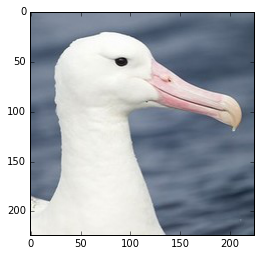

top-5 classes are:
0.002328	oboe
0.002094	birdhouse
0.001958	lionfish
0.001879	barracouta
0.001857	ski


In [10]:
img = imread('albatross.jpg')
plt.imshow(img)
plt.show()

p = prob(preprocess(img))

labels = p.ravel().argsort()[-1:-6:-1]
print('top-5 classes are:')
for l in labels:
    print('%3f\t%s' % (p.ravel()[l], classes[l].split(',')[0]))

# Grand-quest: Dogs Vs Cats
* original competition
* https://www.kaggle.com/c/dogs-vs-cats
* 25k JPEG images of various size, 2 classes (guess what)

### Your main objective
* In this seminar your goal is to fine-tune a pre-trained model to distinguish between the two rivaling animals
* The first step is to just reuse some network layer as features

In [ ]:
!wget https://www.dropbox.com/s/d61lupw909hc785/dogs_vs_cats.train.zip?dl=1 -O data.zip
!unzip data.zip

# for starters
* Train sklearn model, evaluate validation accuracy (should be >80%

In [3]:
#extract features from images
from tqdm import tqdm
from scipy.misc import imresize
import os


DATASET_SIZE = len(os.listdir('train/'))

#this may be a tedious process. If so, store the results in some hdf5 file and re-use them.
f = h5py.File("data.hdf5", "w")
X = f.create_dataset('X', (DATASET_SIZE, 3*IMAGE_W*IMAGE_W), dtype='int16')
Y = f.create_dataset('Y', (DATASET_SIZE,), dtype='int8')
for i, fname in enumerate(tqdm(os.listdir('train/'))):
    y = fname.startswith("cat")
    img = imread("train/"+fname)
    img = preprocess(imresize(img,(IMAGE_W,IMAGE_W)))
    features = img.flatten()
    X[i] = features
    Y[i] = y

100%|██████████| 25000/25000 [08:03<00:00, 47.28it/s]


In [11]:
f = h5py.File("data.hdf5", "r")

X = f['X']
Y = f['Y']
assert X.ndim==2
#WARNING! the concatenate works for [1xN] matrices. If you have other format, stack them yourself.

#crop if we ended prematurely
Y = Y[:len(X)]

In [9]:
DATASET_SIZE = 25000
idx = np.arange(DATASET_SIZE)
np.random.seed(0)
np.random.shuffle(idx)
idx_tr = idx[:int(len(idx)*0.8)]
idx_val = idx[int(len(idx)*0.8):int(len(idx)*0.9)]
idx_ts = idx[int(len(idx)*0.9):]

In [7]:
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier,GradientBoostingClassifier,AdaBoostClassifier
from sklearn.linear_model import LogisticRegression, RidgeClassifier, SGDClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import log_loss

In [29]:
def norm_image(img):
    """
    Normalize PIL image

    Normalizes luminance to (mean,std)=(0,1), and applies a [1%, 99%] contrast stretch
    """
    img_y, img_b, img_r = img.convert('YCbCr').split()

    img_y_np = np.asarray(img_y).astype(float)

    img_y_np /= 255
    img_y_np -= img_y_np.mean()
    img_y_np /= img_y_np.std()
    scale = np.max([np.abs(np.percentile(img_y_np, 1.0)),
                    np.abs(np.percentile(img_y_np, 99.0))])
    img_y_np = img_y_np / scale
    img_y_np = np.clip(img_y_np, -1.0, 1.0)
    img_y_np = (img_y_np + 1.0) / 2.0

    img_y_np = (img_y_np * 255 + 0.5).astype(np.uint8)

    img_y = Image.fromarray(img_y_np)

    img_ybr = Image.merge('YCbCr', (img_y, img_b, img_r))

    img_nrm = img_ybr.convert('RGB')

    return img_nrm


In [26]:
BATCH_SIZE = 500

clf_sgd = SGDClassifier(loss='log', n_iter=1, penalty='l2', ) # shuffle=True is useless here

n_iter = 15
for n in range(n_iter):
    np.random.shuffle(idx_tr)
    for i in tqdm(range(int(len(idx_tr)/BATCH_SIZE))):
        batch_idx = sorted(idx_tr[i*BATCH_SIZE:(i+1)*BATCH_SIZE])
        clf_sgd.partial_fit(X[batch_idx], Y[batch_idx], classes=np.unique(Y))
    loss = 0
    for i in tqdm(range(int(len(idx_tr)/BATCH_SIZE))):
        batch_idx = sorted(idx_tr[i*BATCH_SIZE:(i+1)*BATCH_SIZE])
        sig_clf_probs = clf_sgd.predict_proba(X[batch_idx])
        loss += log_loss(Y[batch_idx], sig_clf_probs)
    print('number of epoch is {} and loss is {}'.format(n+1, loss))


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 1 and loss is 615.9645382268371


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 2 and loss is 551.7224141323032


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 3 and loss is 604.7048971220964


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 4 and loss is 508.75617629703436


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 5 and loss is 525.2657114138015


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 6 and loss is 488.17106556566756


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 7 and loss is 474.14832234933385


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 8 and loss is 445.4811379415581


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 9 and loss is 472.2832284240086


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 10 and loss is 506.47661705497006


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 11 and loss is 438.91877042652504


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 12 and loss is 409.49173293806103


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 13 and loss is 429.6623819742441


  0%|          | 0/40 [00:00<?, ?it/s]

number of epoch is 14 and loss is 472.559538635168


100%|██████████| 40/40 [00:10<00:00,  3.76it/s]

number of epoch is 15 and loss is 414.3271616333486


In [23]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

Y_pred_tr = []
for i in tqdm(idx_tr):
    Y_pred_tr.append(clf_sgd.predict(X[i])[0])
    
print("training accuracy", accuracy_score(Y[idx_tr], Y_pred_tr))

Y_pred_val = []
for i in tqdm(idx_val):
    Y_pred_val.append(clf_sgd.predict(X[i])[0])
    
print("validation accuracy", accuracy_score(Y[idx_val], Y_pred_val))

  0%|          | 8/2500 [00:00<00:32, 76.08it/s]

training accuracy 0.7173


100%|██████████| 2500/2500 [00:41<00:00, 60.65it/s]

validation accuracy 0.546


__load our dakka__
![img](https://s-media-cache-ak0.pinimg.com/564x/80/a1/81/80a1817a928744a934a7d32e7c03b242.jpg)

# Main quest

* Get the score improved!

No methods are illegal: ensembling, data augmentation, NN hacks. 
Just don't let test data slip into training.

The main requirement is that you implement the NN fine-tuning recipe:
### Split the raw image data
  * please do train/validation/test instead of just train/test
  * reasonable but not optimal split is 20k/2.5k/2.5k or 15k/5k/5k
### Choose which vgg layers are you going to use
  * Anything but for prob is okay
  * Do not forget that vgg16 uses dropout
### Build a few layers on top of chosen "neck" layers.
  * a good idea is to just stack more layers inside the same network
  * alternative: stack on top of get_output
### Train the newly added layers for some iterations
  * you can selectively train some weights by only sending them to your optimizer
      * `lasagne.updates.mysupermegaoptimizer(loss, only_those_weights_i_wanna_train)`
  * selecting all weights from the head but not below the neck:
      * `all_params = lasagne.layers.get_all_params(new_output_layer_or_layers,trainable=True)`
      * `old_params= lasagne.layers.get_all_params(neck_layers,trainable=True)`
      * `new_params = [w for w in all_params if w not in old_params]`
  * it's cruicial to monitor the network performance at this and following steps
### Fine-tune the network body
  * probably a good idea to SAVE your new network weights now 'cuz it's easy to mess things up.
  * Moreover, saving weights periodically is a no-nonsense idea
  * even more cruicial to monitor validation performance
  * main network body may need a separate, much lower learning rate
      * since updates are dictionaries, one can just compute union
      * `updates = {}`
      * `updates.update(lasagne.updates.how_i_optimize_old_weights())`
      * `updates.update(lasagne.updates.how_i_optimize_old_weights())`
      * make sure they do not have overlapping keys. Otherwise, earlier one will be forgotten.
      * `assert len(updates) == len(old_updates) + len(new_updates)`
### PROFIT!!!
  * Evaluate the final score
  * Submit to kaggle
      * competition page https://www.kaggle.com/c/dogs-vs-cats
      * get test data https://www.kaggle.com/c/dogs-vs-cats/data
  
## Some ways to get bonus points
* explore other networks from the model zoo
* play with architecture
* 85%/90%/93%/95%/97% kaggle score (screen pls).
* data augmentation, prediction-time data augmentation
* use any more advanced fine-tuning technique you know/read anywhere
* ml hacks that benefit the final score


In [7]:
lasagne.layers.set_all_param_values(net['prob'], weights)

input_image = T.tensor4('input')
fc7_fc8_layer = lasagne.layers.get_output([net['fc7'], net['fc8']], input_image)
fc7_fc8_features = theano.function([input_image], fc7_fc8_layer) 

# Extract features from images using vgg network

In [10]:
from tqdm import tqdm
from scipy.misc import imresize
import os


DATASET_SIZE = len(os.listdir('train/'))
BATCH_SIZE = 50

#this may be a tedious process. If so, store the results in some hdf5 file and re-use them.
f = h5py.File("vgg_features_fc7_fc8.hdf5", "w")
X_fc7 = f.create_dataset('X_fc7', (DATASET_SIZE, 4096), dtype='float32')
X_fc8 = f.create_dataset('X_fc8', (DATASET_SIZE, 1000), dtype='float32')
Y = f.create_dataset('Y', (DATASET_SIZE,), dtype='int8')
imgs = np.zeros((BATCH_SIZE, 3, IMAGE_W, IMAGE_W))
for i, fname in enumerate(tqdm(os.listdir('train/'))):
    y = fname.startswith("cat")
    img = imread("train/"+fname)
    imgs[i%BATCH_SIZE] = preprocess(imresize(img,(IMAGE_W,IMAGE_W)))
    if i != 0 and i%BATCH_SIZE == 0:
        fc7_fc8 = fc7_fc8_features(imgs)
        X_fc7[list(np.arange(i - BATCH_SIZE, i))] = fc7_fc8[0]
        X_fc8[list(np.arange(i - BATCH_SIZE, i))] = fc7_fc8[1]
    Y[i] = y
    
    


100%|██████████| 25000/25000 [13:19:49<00:00,  1.92s/it]


In [5]:
f_vgg = h5py.File("vgg_features_fc7_fc8.hdf5", "r")

X_fc7 = f_vgg['X_fc7']
X_fc8 = f_vgg['X_fc8']
Y = f_vgg['Y']

#crop if we ended prematurely
Y = Y[:len(X_fc7)]

In [396]:
X_fc7_fc8 = np.concatenate((X_fc7, X_fc8), axis=1) + .9e-3

In [119]:
clf_sgd = SGDClassifier(loss='hinge', n_iter=6, alpha=1, random_state=1)
clf_sgd.fit(X_fc7_fc8[sorted(idx_tr)], Y[sorted(idx_tr)])
clf_sgd.score(X_fc7_fc8[sorted(idx_val)], Y[sorted(idx_val)])

0.97519999999999996

In [769]:
clf_sgd.score(X_fc7_fc8[sorted(idx_ts)], Y[sorted(idx_ts)])

0.97319999999999995

In [794]:
input_X = T.matrix("X")

#input dimention (None means "Arbitrary" and only works at  the first axes [samples])
input_shape = [None,5096]

target_y = T.vector("target Y integer",dtype='int32')

In [864]:
import lasagne
from lasagne.layers import *

#Input layer (auxilary)
l1 = InputLayer(shape = input_shape,input_var=input_X)

l2 = DropoutLayer(l1, p=0.3)

l3= DenseLayer(l2,num_units=200, nonlinearity=lasagne.nonlinearities.sigmoid)

l4= DenseLayer(l3,num_units=200, nonlinearity=lasagne.nonlinearities.rectify)

l5= DenseLayer(l4,num_units=200, nonlinearity=lasagne.nonlinearities.rectify)

l6= DenseLayer(l5,num_units=200, nonlinearity=lasagne.nonlinearities.sigmoid)

l_out = DenseLayer(l6, num_units = 1, nonlinearity=lasagne.nonlinearities.sigmoid)

In [865]:
#all network weights (shared variables)
all_weights = lasagne.layers.get_all_params(l_out)
print(all_weights)

[W, b, W, b, W, b, W, b, W, b]


In [866]:
#network prediction (theano-transformation)
y_predicted = lasagne.layers.get_output(l_out)

In [872]:
from lasagne.regularization import regularize_layer_params_weighted
from lasagne.regularization import regularize_layer_params


loss = lasagne.objectives.binary_hinge_loss(y_predicted,target_y, log_odds=False, delta=0.5).mean()

weightsl2 = lasagne.regularization.regularize_network_params(l_out, lasagne.regularization.l2)


#prediction accuracy
accuracy = lasagne.objectives.binary_accuracy(y_predicted,target_y).mean()

lr = 0.01
weight_decayl2 = 0.000001

loss += weight_decayl2 * weightsl2

#This function computes gradient AND composes weight updates just like you did earlier
updates_sgd = lasagne.updates.sgd(loss, all_weights,learning_rate=lr)

In [873]:
#function that computes loss and updates weights
train_fun = theano.function([input_X,target_y],[loss,accuracy],updates= updates_sgd)

#function that just computes accuracy
accuracy_fun = theano.function([input_X,target_y],accuracy)


prediction = lasagne.layers.get_output(l_out, deterministic=True)
result = T.round_half_away_from_zero(prediction)
predict_fn = theano.function([input_X],result)


In [839]:
X_train = X_fc7_fc8[sorted(idx_tr)]
y_train = Y[sorted(idx_tr)]

X_val = X_fc7_fc8[sorted(idx_val)]
y_val = Y[sorted(idx_val)]

X_test = X_fc7_fc8[sorted(idx_ts)]
y_test = Y[sorted(idx_ts)]

In [840]:
# An auxilary function that returns mini-batches for neural network training

#Parameters
# inputs - a tensor of images with shape (many, 1, 28, 28), e.g. X_train
# outputs - a vector of answers for corresponding images e.g. Y_train
#batch_size - a single number - the intended size of each batches

def iterate_minibatches(inputs, targets, batchsize):
    assert len(inputs) == len(targets)
    indices = np.arange(len(inputs))
    np.random.shuffle(indices)
    for start_idx in range(0, len(inputs) - batchsize + 1, batchsize):
        excerpt = indices[start_idx:start_idx + batchsize]
        yield inputs[excerpt], targets[excerpt]

In [876]:
import time

num_epochs = 5#amount of passes through the data

batch_size = 256 #number of samples processed at each function call

for epoch in range(num_epochs):
    # In each epoch, we do a full pass over the training data:
    train_err = 0
    train_acc = 0
    train_batches = 0
    start_time = time.time()
    for batch in iterate_minibatches(X_train, y_train,batch_size):
        inputs, targets = batch
        train_err_batch, train_acc_batch= train_fun(inputs, targets)
        train_err += train_err_batch
        train_acc += train_acc_batch
        train_batches += 1

    # And a full pass over the validation data:
    val_acc = 0
    val_batches = 0
    for batch in iterate_minibatches(X_val, y_val, batch_size):
        inputs, targets = batch
        val_acc += accuracy_fun(inputs, targets)
        val_batches += 1

    
    # Then we print the results for this epoch:
    print("Epoch {} of {} took {:.3f}s".format(
        epoch + 1, num_epochs, time.time() - start_time))

    print("  training loss (in-iteration):\t\t{:.6f}".format(train_err / train_batches))
    print("  train accuracy:\t\t{:.2f} %".format(
        train_acc / train_batches * 100))
    print("  validation accuracy:\t\t{:.2f} %".format(
        val_acc / val_batches * 100))
    if train_acc / train_batches * 100 > 97.8 and val_acc / val_batches * 100 >=  97.8:
        break

Epoch 1 of 5 took 10.750s
  training loss (in-iteration):		0.005605
  train accuracy:		99.57 %
  validation accuracy:		97.22 %
Epoch 2 of 5 took 12.106s
  training loss (in-iteration):		0.005683
  train accuracy:		99.57 %
  validation accuracy:		97.22 %
Epoch 3 of 5 took 13.489s
  training loss (in-iteration):		0.005632
  train accuracy:		99.55 %
  validation accuracy:		97.01 %
Epoch 4 of 5 took 18.470s
  training loss (in-iteration):		0.005559
  train accuracy:		99.56 %
  validation accuracy:		97.18 %
Epoch 5 of 5 took 12.665s
  training loss (in-iteration):		0.005577
  train accuracy:		99.57 %
  validation accuracy:		96.57 %


## False classified images from val set.

In [881]:
fn_and_fp_val = []
for index in sorted(idx_val):
    if predict_fn(X_fc7_fc8[index].reshape(1, 5096)) != Y[index]:
        fn_and_fp_val.append(index)

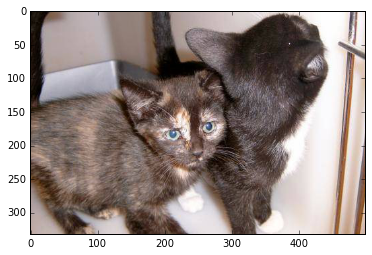

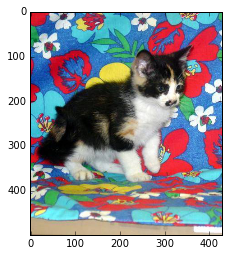

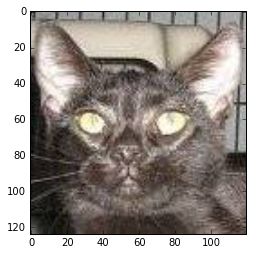

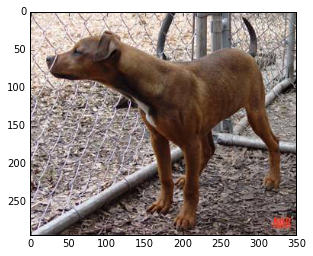

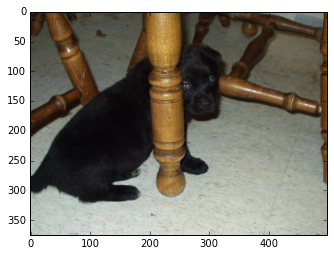

...

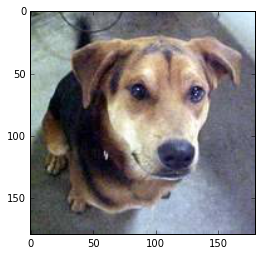

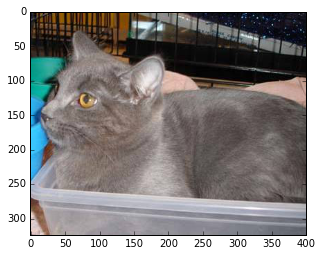

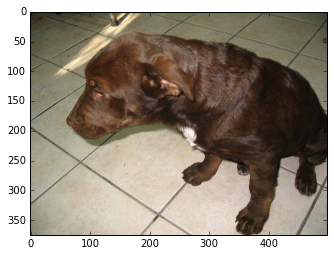

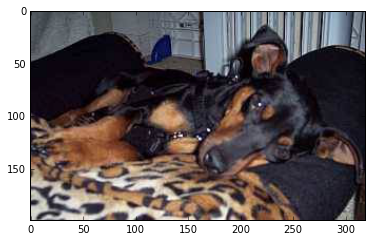

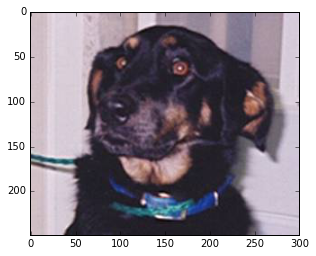

In [763]:
for i, fname in enumerate(os.listdir('train/')):
    if i in fn_and_fp_val:
        img = imread("train/"+fname)
        plt.imshow(img)
        plt.show()

In [878]:
fn_and_fp_tr = []
for index in sorted(idx_tr):
    if predict_fn(X_fc7_fc8[index].reshape(1, 5096)) != Y[index]:
        fn_and_fp_tr.append(index)

dog


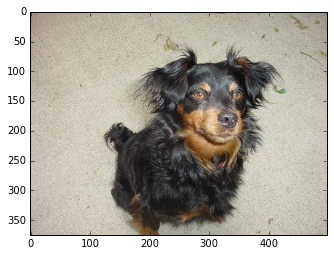

dog


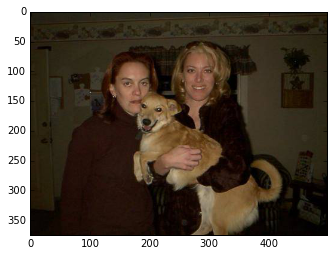

dog


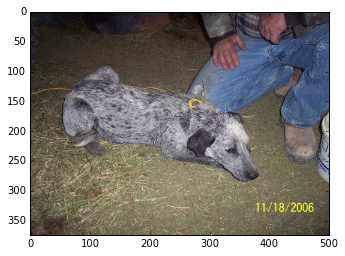

dog


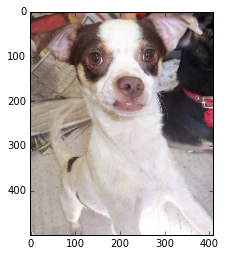

dog


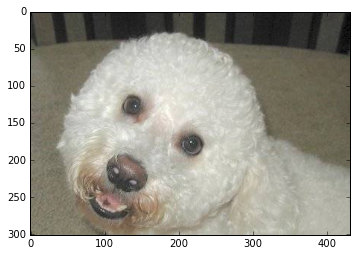

dog


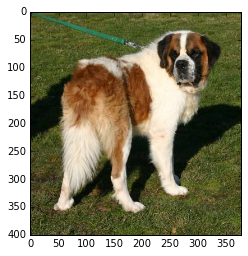

dog


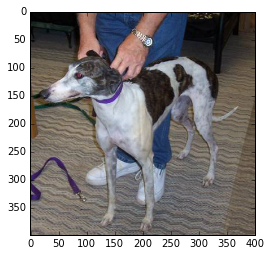

dog


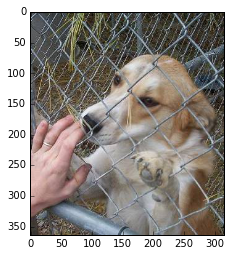

dog


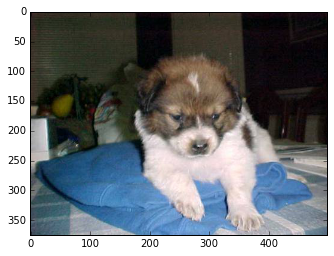

dog


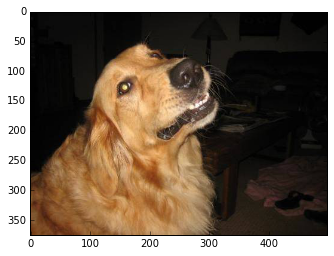

dog


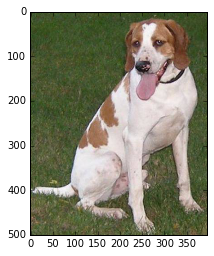

dog


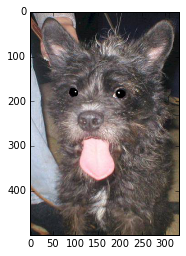

dog


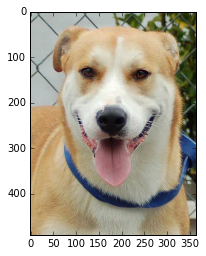

dog


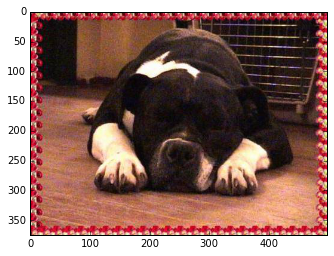

dog


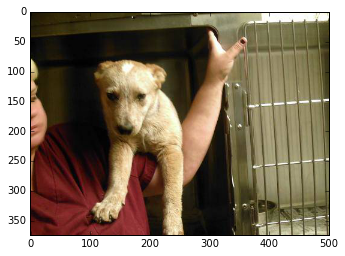

dog


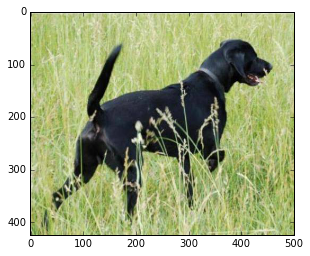

dog


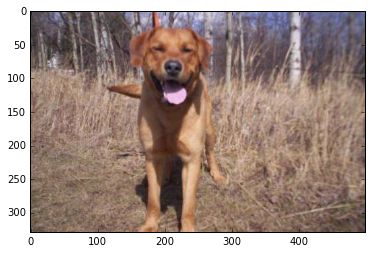

dog


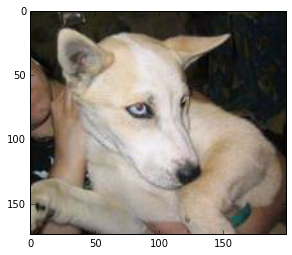

dog


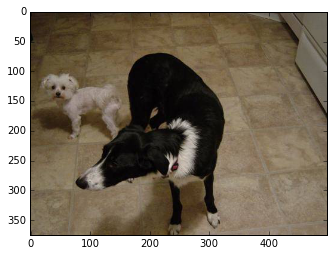

dog


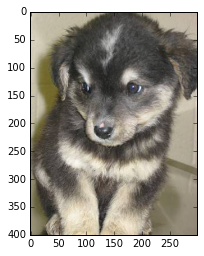

dog


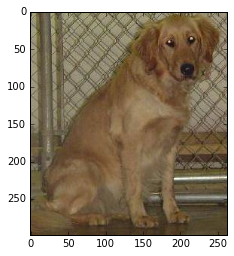

dog


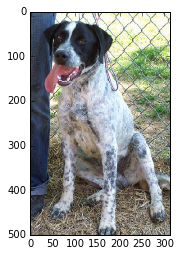

dog


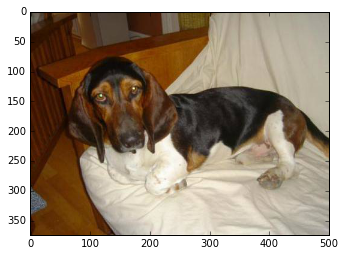

dog


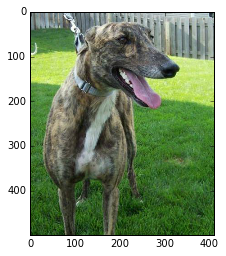

dog


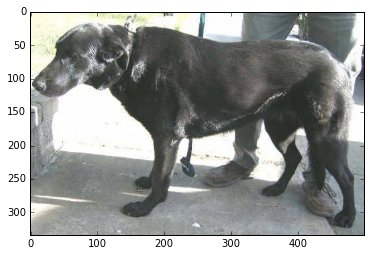

dog


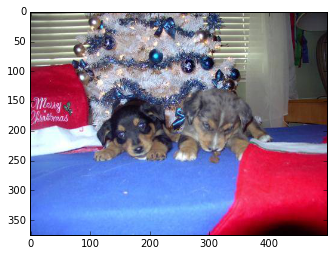

dog


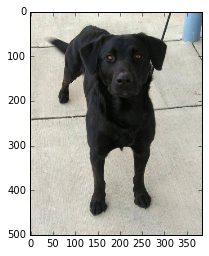

dog


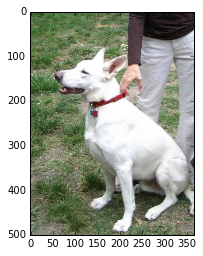

dog


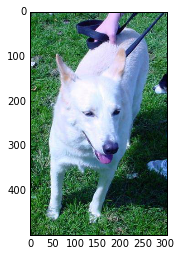

dog


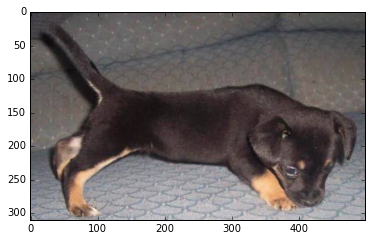

dog


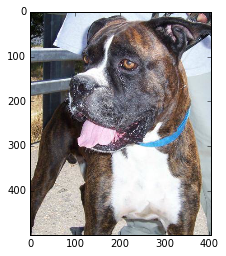

dog


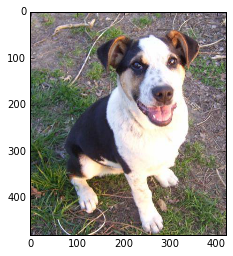

dog


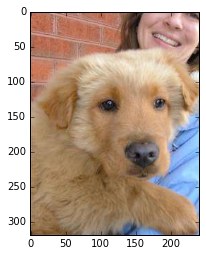

dog


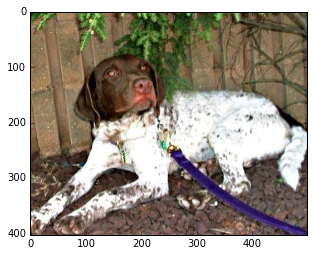

dog


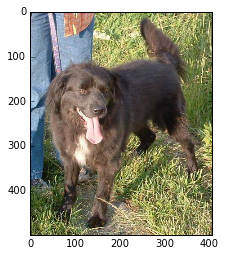

dog


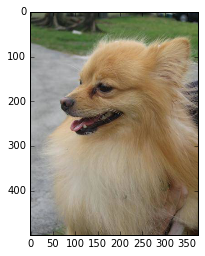

dog


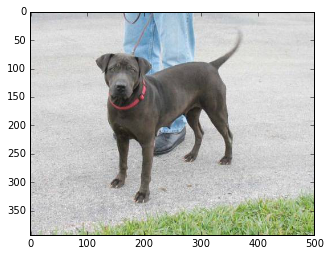

dog


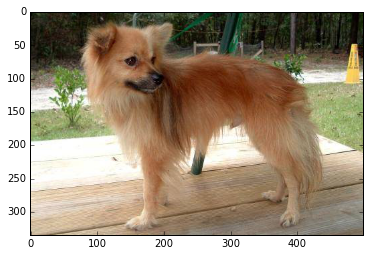

dog


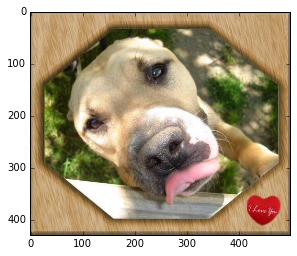

dog


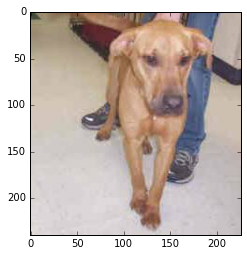

dog


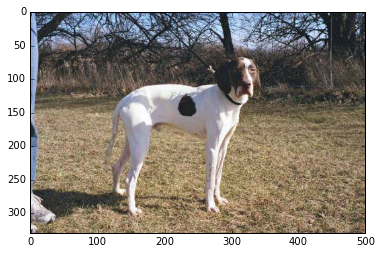

dog


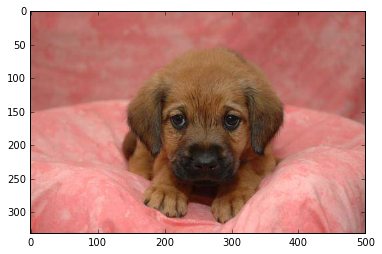

dog


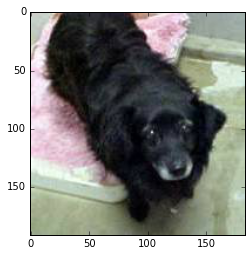

dog


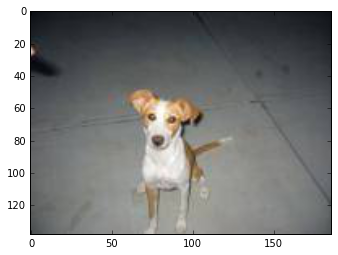

dog


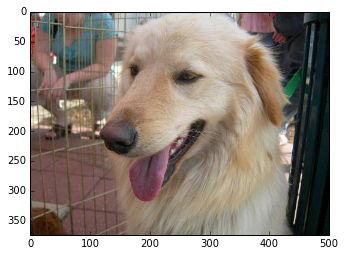

dog


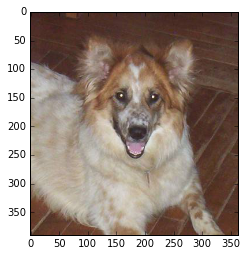

dog


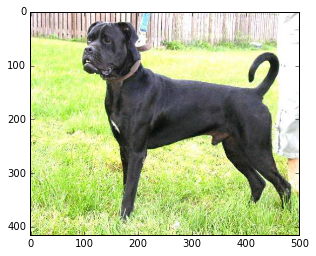

dog


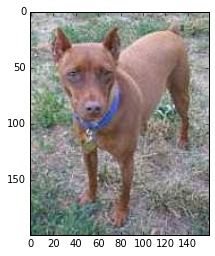

dog


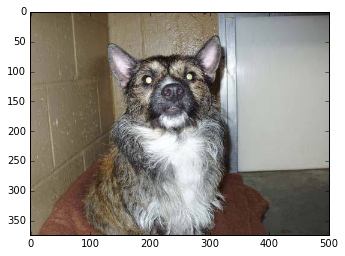

dog


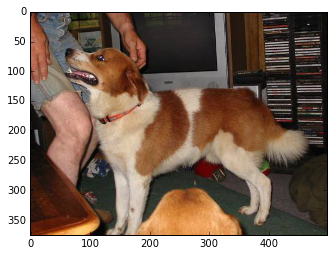

dog


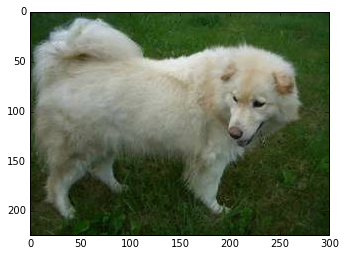

dog


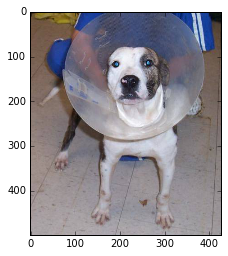

dog


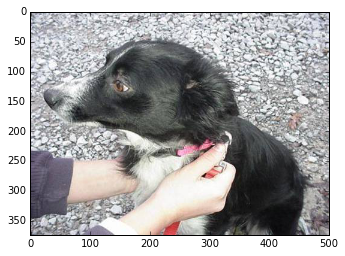

dog


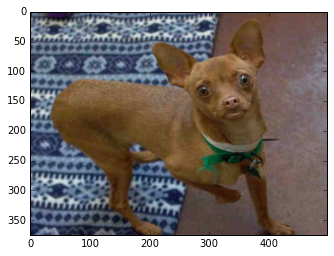

dog


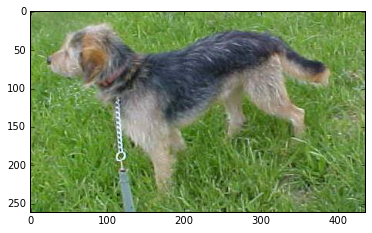

dog


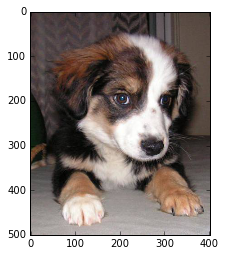

dog


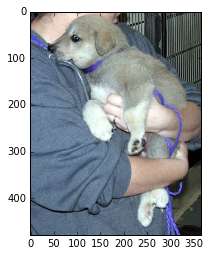

dog


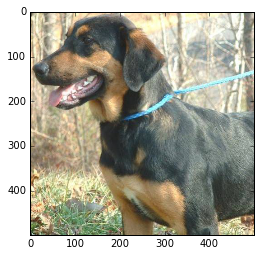

dog


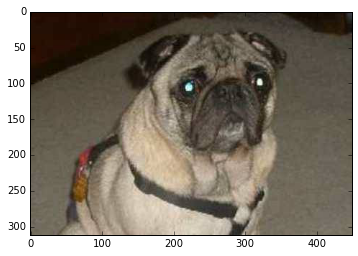

dog


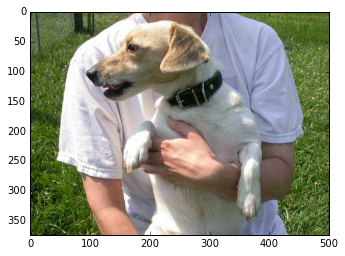

dog


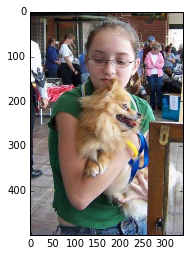

dog


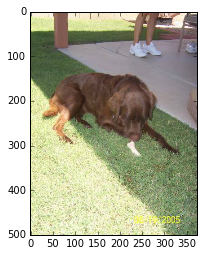

dog


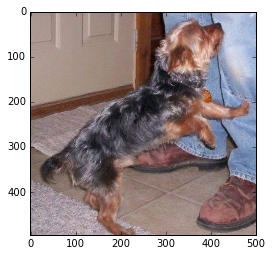

dog


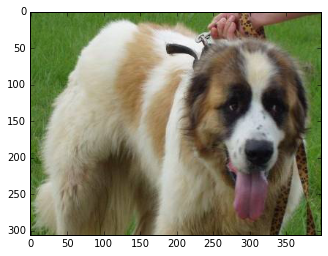

dog


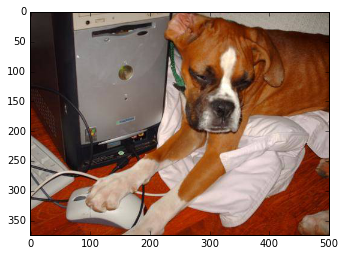

dog


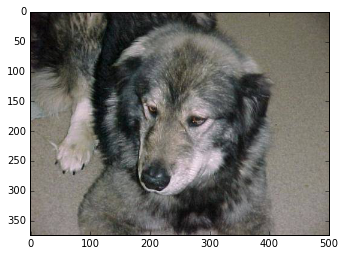

dog


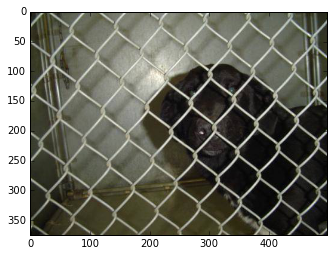

dog


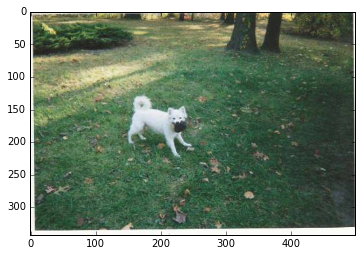

dog


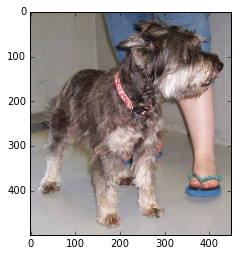

dog


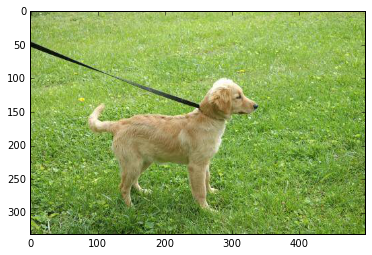

dog


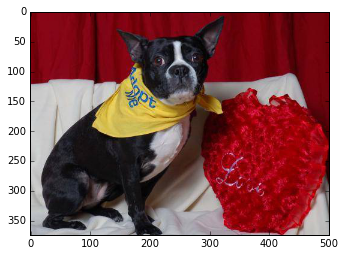

dog


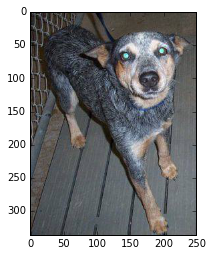

dog


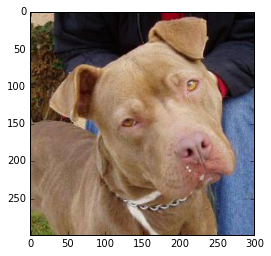

dog


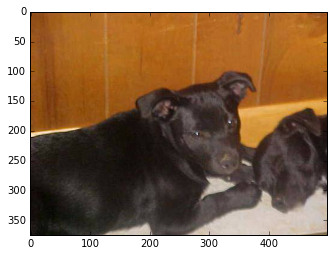

dog


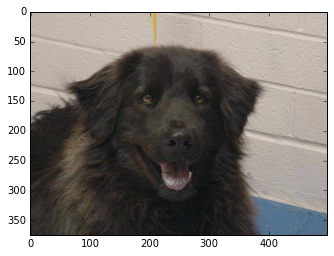

dog


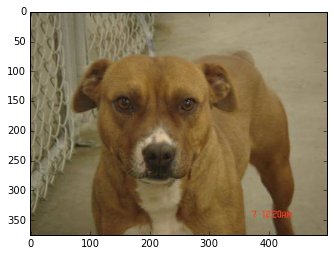

dog


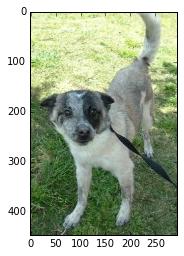

dog


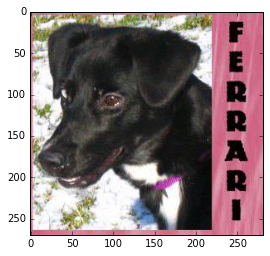

dog


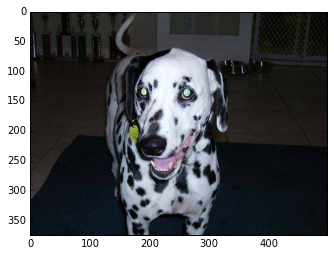

dog


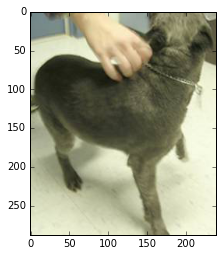

In [879]:
for i, fname in enumerate(os.listdir('train/')):
    if i in fn_and_fp_tr:
        if fname.startswith("cat"):
            print('cat')
        else:
            print('dog')
        img = imread("train/"+fname)
        plt.imshow(img)
        plt.show()

In [880]:
test_acc = 0
test_batches = 0
for batch in iterate_minibatches(X_test, y_test, 500):
    inputs, targets = batch
    acc = accuracy_fun(inputs, targets)
    test_acc += acc
    test_batches += 1
print("Final results:")
print("  test accuracy:\t\t{:.2f} %".format(
    test_acc / test_batches * 100))


Final results:
  test accuracy:		97.24 %
